## <b>Weather forecast project 

# <b>02 - DATA PREPROCESSING

### Packages nécessaires au notebook :

In [1]:
import numpy as np
import pandas as pd
import matplotlib
import bokeh 
import plotly
import sys
import plotly.express as px
import pandas_profiling as pp
#cf commentaire ci-dessous si le module n'est pas installé

from sklearn.preprocessing import LabelEncoder


%matplotlib inline
import matplotlib.pyplot as plt

import seaborn as sns

sns.set_style('darkgrid')
sns.set_palette('Set2')

from geopy.geocoders import Nominatim
import folium
from folium.plugins import HeatMap
import calendar

from datetime import datetime
from termcolor import colored
from IPython.display import Image

import warnings
warnings.filterwarnings("ignore", category=UserWarning, module="matplotlib")


import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) # to avoid deprecation warnings


import pandas as pd
import geopy.distance
from collections import defaultdict


import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import matplotlib.pyplot as plt
import seaborn as sns

import geopandas as gpd
from shapely.geometry import Point

from mpl_toolkits.axes_grid1 import make_axes_locatable
# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

from sklearn.neighbors import DistanceMetric
from math import radians

from tqdm import tqdm
# Afficher l'état d'avancement
tqdm.pandas()


import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import warnings
from sklearn.decomposition import PCA
warnings.filterwarnings("ignore")
sns.set_theme()
from sklearn.preprocessing import StandardScaler

In [2]:
# Fonctions utiles pour le notebook qui sont utilisées plusieurs fois
# Données manquantes
def missing_values(df):
    missing_counts = df.isnull().sum().rename('missing_count')
    no_missing_counts = df.notnull().sum().rename('no_missing_count')
    missing_percentages = (missing_counts / (missing_counts + no_missing_counts)).rename('missing_percentage')
    missing_df = pd.DataFrame({'missing_count': missing_counts, 'no_missing_count': no_missing_counts, 'missing_percentage': missing_percentages})
    missing_df['missing_percentage'] = missing_df['missing_percentage'].map('{:.2%}'.format)
    return missing_df.sort_values('missing_count', ascending=False)

 ### Import des données

In [3]:
# Import des datasets
print("Chargement des datasets...")
df = pd.read_csv("../data/weatherAUS.csv")
aus_town_gps = pd.read_csv("../data/aus_town_gps.csv",sep=",")
climatsaus = pd.read_csv("../data/climatsAUS_v2.csv",sep=";")
print("...Terminé.")
print()

Chargement des datasets...
...Terminé.



In [4]:
# Post-traitement des noms des colonnes
df.columns = df.columns.str.lower()
aus_town_gps.columns = aus_town_gps.columns.str.lower()
climatsaus.columns = climatsaus.columns.str.lower()

In [5]:
#Fusion des dataframes
df = pd.merge(df, aus_town_gps, how='left', left_on="location",right_on="location")
df = pd.merge(df, climatsaus, how='left', left_on="location",right_on="location")

In [6]:
# Chagement du type date en datetime
df['date'] = pd.to_datetime(df['date'], format='%Y-%m-%d')
df['year'] = df['date'].dt.year.astype('int16')
df['month'] = df['date'].dt.month.astype('int16')
df['day'] = df['date'].dt.day.astype('int16')

In [7]:
# Variables utiles pour le postraitement
longitudes = list(aus_town_gps.longitude)
latitudes = list(aus_town_gps.latitude)
villes = list(aus_town_gps.location)

### Ajout des caractéristiques climatiques des villes

In [8]:
# Regroupement des climats en 4 catégories : chaud_humide, tempéré_froid, sec et méditerranéen. 
climats_type = {'Am':'chaud_humide',
                'Aw':'chaud_humide',
                'Cfa':'chaud_humide',
                'Cfb':'tempéré_froid', 
                'Cfc':'tempéré_froid', 
                'BSh':'sec',
                'BSk':'sec',
                'Bsk':'sec', 
                'Bwh':'sec',
                'Csa':'méditerranéen',
                'Csb':'méditerranéen'              
               }

df['climat']=df['climat_koppen'].map(climats_type)

In [9]:
missing_values(df)

,missing_count,no_missing_count,missing_percentage
sunshine,69835,75625,48.01%
evaporation,62790,82670,43.17%
cloud3pm,59358,86102,40.81%
cloud9am,55888,89572,38.42%
pressure9am,15065,130395,10.36%
pressure3pm,15028,130432,10.33%
winddir9am,10566,134894,7.26%
windgustdir,10326,135134,7.10%
windgustspeed,10263,135197,7.06%
humidity3pm,4507,140953,3.10%


### Traitement des valeurs manquantes de : sunshine, evaporation, cloud3pm, cloud9am

In [10]:
# Dictionnaire des villes les plus proches dans le même climat de Köppen
villes_proches_par_climat = defaultdict(list)

for ville in df["location"].unique():
    data_ville = df[df["location"] == ville]
    climat_ville = data_ville.iloc[0]["climat_koppen"]
    lat_ville = data_ville.iloc[0]["latitude"]
    lon_ville = data_ville.iloc[0]["longitude"]
    for autre_ville in df["location"].unique():
        if autre_ville != ville:
            data_autre_ville = df[df["location"] == autre_ville]
            climat_autre_ville = data_autre_ville.iloc[0]["climat_koppen"]
            if climat_autre_ville == climat_ville:
                lat_autre_ville = data_autre_ville.iloc[0]["latitude"]
                lon_autre_ville = data_autre_ville.iloc[0]["longitude"]
                distance = geopy.distance.geodesic((lat_ville, lon_ville), (lat_autre_ville, lon_autre_ville)).km
                if distance < 500:
                    villes_proches_par_climat[ville].append((autre_ville, distance))
    villes_proches_par_climat[ville].sort(key=lambda x: x[1])
print(villes_proches_par_climat)

defaultdict(<class 'list'>, {'Albury': [('WaggaWagga', 170.56817640486216), ('BadgerysCreek', 428.94497747708596), ('Penrith', 432.1702537699683), ('SydneyAirport', 455.23423960330297), ('Sydney', 464.30789868864946)], 'BadgerysCreek': [('Penrith', 15.223106799869479), ('Sydney', 37.794462805224974), ('SydneyAirport', 41.15322946568301), ('NorahHead', 98.31290855001555), ('Newcastle', 140.20655197250213), ('Williamtown', 209.55881995103334), ('WaggaWagga', 345.1234288052125), ('Albury', 428.94497747708596), ('CoffsHarbour', 457.3716398903428), ('Moree', 495.27049184897606)], 'Cobar': [], 'CoffsHarbour': [('Williamtown', 247.8268967414969), ('GoldCoast', 249.34202828287877), ('Newcastle', 322.67119079373043), ('Moree', 326.8660259900974), ('Brisbane', 342.6291848827666), ('NorahHead', 367.0533507381007), ('Sydney', 431.87879048515094), ('Penrith', 448.69824261184664), ('SydneyAirport', 449.65579037585655), ('BadgerysCreek', 457.3716398903428)], 'Moree': [('CoffsHarbour', 326.86602599009

In [11]:
# Fonction permettant de remplacer les NaNs 
def remplacer_valeurs_manquantes(row, col):
    ville = row['location']
    date = row['date']
    val = row[col]
    if np.isnan(val):
        for ville_proche, distance in villes_proches_par_climat[ville]:
            row_proche = df[(df['location'] == ville_proche) & (df['date'] == date)]
            if not row_proche.empty:
                val_proche = row_proche.iloc[0][col]
                if not np.isnan(val_proche):
                    return val_proche
            else:
                row_proche_veille = df[(df['location'] == ville_proche) & (df['date'] == date - pd.Timedelta(days=1))]
                row_proche_demain = df[(df['location'] == ville_proche) & (df['date'] == date + pd.Timedelta(days=1))]
                if not row_proche_veille.empty:
                    val_proche = row_proche_veille.iloc[0][col]
                    if not np.isnan(val_proche):
                        return val_proche
                elif not row_proche_demain.empty:
                    val_proche = row_proche_demain.iloc[0][col]
                    if not np.isnan(val_proche):
                        return val_proche
    return val

In [12]:
df.to_csv('df_pyspark.csv')

In [14]:
df['sunshine'] = df.progress_apply(remplacer_valeurs_manquantes, args=('sunshine',), axis=1)
df['cloud9am'] = df.progress_apply(remplacer_valeurs_manquantes, args=('cloud9am',), axis=1)
df['cloud3pm'] = df.progress_apply(remplacer_valeurs_manquantes, args=('cloud3pm',), axis=1)
df['evaporation'] = df.progress_apply(remplacer_valeurs_manquantes, args=('evaporation',), axis=1)

100%|██████████| 145460/145460 [10:26<00:00, 232.35it/s]  


In [15]:
df.to_csv('df_progress_apply.csv')

In [16]:
missing_values(df)

,missing_count,no_missing_count,missing_percentage
sunshine,21163,124297,14.55%
cloud3pm,17758,127702,12.21%
cloud9am,16999,128461,11.69%
evaporation,15346,130114,10.55%
pressure9am,15065,130395,10.36%
pressure3pm,15028,130432,10.33%
winddir9am,10566,134894,7.26%
windgustdir,10326,135134,7.10%
windgustspeed,10263,135197,7.06%
humidity3pm,4507,140953,3.10%


### Modification des noms des villes

In [17]:
badly_named = {"AliceSprings":"Alice Springs",
               "BadgerysCreek":"Badgerys Creek",
               "CoffsHarbour": "Coffs Harbour",
               "GoldCoast": "Gold Coast",
               "MelbourneAirport": "Melbourne Airport",
               "MountGambier": "Mount Gambier",
               "MountGinini": "Mount Ginini",
               "NorahHead": "Norah Head",
               "NorfolkIsland": "Norfolk Island",
               "PearceRAAF": "Pearce RAAF",
               "PerthAirport": "Perth Airport",
               "SalmonGums": "Salmon Gums",
               "SydneyAirport": "Sydney Airport",
               "WaggaWagga": "Wagga Wagga"}
df["location"] = df["location"].apply(lambda x: badly_named[x] if x in badly_named.keys() else x)

### Suppression des valeurs manquantes

In [18]:
df = df.dropna(axis = 0, how = 'any') 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96158 entries, 0 to 145034
Data columns (total 30 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           96158 non-null  datetime64[ns]
 1   location       96158 non-null  object        
 2   mintemp        96158 non-null  float64       
 3   maxtemp        96158 non-null  float64       
 4   rainfall       96158 non-null  float64       
 5   evaporation    96158 non-null  float64       
 6   sunshine       96158 non-null  float64       
 7   windgustdir    96158 non-null  object        
 8   windgustspeed  96158 non-null  float64       
 9   winddir9am     96158 non-null  object        
 10  winddir3pm     96158 non-null  object        
 11  windspeed9am   96158 non-null  float64       
 12  windspeed3pm   96158 non-null  float64       
 13  humidity9am    96158 non-null  float64       
 14  humidity3pm    96158 non-null  float64       
 15  pressure9am    961

### Ajout des caractéristiques géographiques des villes

In [19]:
# caractéristiques géographiques (attention, il y a des coquilles, dictionnaire à consolider)
geography = {
    'Albury': 'valley',
    'Badgerys Creek': 'coastal',
    'Cobar': 'desert',
    'Coffs Harbour': 'coastal',
    'Moree': 'valley',
    'Newcastle': 'coastal',
    'Norah Head': 'coastal',
    'Norfolk Island': 'island',
    'Penrith': 'coastal',
    'Richmond': 'valley',
    'Sydney': 'coastal',
    'Sydney Airport': 'coastal',
    'Wagga Wagga': 'valley',
    'Williamtown': 'valley',
    'Wollongong': 'coastal',
    'Canberra': 'mountainous',
    'Tuggeranong': 'mountainous',
    'Mount Ginini': 'mountainous',
    'Ballarat': 'valley',
    'Bendigo': 'valley',
    'Sale': 'valley',
    'Melbourne Airport': 'valley',
    'Melbourne': 'valley',
    'Mildura': 'desert',
    'Nhil': 'mountainous',
    'Portland': 'coastal',
    'Watsonia': 'valley',
    'Dartmoor': 'valley',
    'Brisbane': 'coastal',
    'Cairns': 'coastal',
    'Gold Coast': 'coastal',
    'Townsville': 'coastal',
    'Adelaide': 'coastal',
    'Mount Gambier': 'valley',
    'Nuriootpa': 'valley',
    'Woomera': 'desert',
    'Albany': 'coastal',
    'Witchcliffe': 'coastal',
    'Pearce RAAF': 'coastal',
    'Perth Airport': 'coastal',
    'Perth': 'coastal',
    'Salmon Gums': 'valley',
    'Walpole': 'coastal',
    'Hobart': 'coastal',
    'Launceston': 'valley',
    'Alice Springs': 'desert',
    'Darwin': 'coastal',
    'Katherine': 'desert',
    'Uluru': 'desert'
}
df['geography'] = df['location'].map(geography)

### Ajout de la position géographiques des villes

In [20]:
position = {
  'Albury': 'S',
  'Badgerys Creek': 'E',
  'Cobar': 'N',
  'Coffs Harbour': 'S',
  'Moree': 'N',
  'Norah Head': 'S',
  'Norfolk Island': 'E',
  'Sydney': 'E',
  'Sydney Airport': 'E',
  'Wagga Wagga': 'S',
  'Williamtown': 'S',
  'Wollongong': 'S',
  'Canberra': 'S',
  'Tuggeranong': 'S',
  'Ballarat': 'S',
  'Bendigo': 'S',
  'Sale': 'S',
  'Melbourne Airport': 'S',
  'Melbourne': 'S',
  'Mildura': 'S',
  'Portland': 'S',
  'Watsonia': 'S',
  'Dartmoor': 'S',
  'Brisbane': 'E',
  'Cairns': 'E',
  'Gold Coast': 'E',
  'Townsville': 'E',
  'Mount Gambier': 'S',
  'Nuriootpa': 'S',
  'Woomera': 'S',
  'Witchcliffe': 'W',
  'Pearce RAAF': 'W',
  'Perth Airport': 'W',
  'Perth': 'W',
  'Walpole': 'W',
  'Hobart': 'S',
  'Launceston': 'S',
  'Alice Springs': 'N',
  'Darwin': 'N',
  'Katherine': 'N',
  'Uluru': 'S'
}
df['position'] = df['location'].map(position)

### Ajout de l'écart de température en caractéristique

In [21]:
df['temp_amplitude'] = df['maxtemp'] - df['mintemp']

### Aperçu des données

In [22]:
# Définition des couleurs pour chaque type de géographie
colors = {'coastal': 'blue', 'valley': 'green', 'mountainous': 'purple', 'desert': 'darkgoldenrod', 'island' : 'skyblue'}

# Figure Plotly qui permet d'afficher la ville, le climat et les coordonnées GPS en survolant le point
fig = px.scatter_mapbox(df, lat='latitude', lon='longitude', color='geography', color_discrete_map=colors, title='Climats des villes en Australie', hover_name='location', hover_data=['geography'])

# Référence de tuile
fig.update_layout(mapbox_style='carto-positron')

# Limites de la carte et le zoom de départ
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0}, mapbox_center_lat=-25, mapbox_center_lon=135, mapbox_zoom=2)

print("Carte interactive : il est possible de filtrer les champs avec la légende et d'afficher les labels en survolants les points")
fig.show()


Carte interactive : il est possible de filtrer les champs avec la légende et d'afficher les labels en survolants les points


### Sauvegarde du dataframe pour la visualisation

In [23]:
# Regroupement des climats en 4 catégories : chaud_humide, tempéré_froid, sec et méditerranéen. 
climats_type = {'chaud_humide':'Chaud humide',
                'tempéré_froid':'Tempéré froid',
                'sec':'Sec',
                'méditerranéen':'Méditerranéen'          
               }

df['climat']=df['climat'].map(climats_type)

In [24]:
df.to_csv("../data/df_dataviz.csv")

In [ ]:
df.columns

### Identification des variables catégorielles et numériques

In [25]:
categorical_features = [column_name for column_name in df.columns if df[column_name].dtype == 'O']
print("Number of Categorical Features: {}".format(len(categorical_features)))
print("Categorical Features: ",categorical_features)

Number of Categorical Features: 10
Categorical Features:  ['location', 'windgustdir', 'winddir9am', 'winddir3pm', 'raintoday', 'raintomorrow', 'climat_koppen', 'climat', 'geography', 'position']


In [26]:
numerical_features = [column_name for column_name in df.columns if df[column_name].dtype != 'O']
print("Number of Numerical Features: {}".format(len(numerical_features)))
print("Numerical Features: ",numerical_features)

Number of Numerical Features: 23
Numerical Features:  ['date', 'mintemp', 'maxtemp', 'rainfall', 'evaporation', 'sunshine', 'windgustspeed', 'windspeed9am', 'windspeed3pm', 'humidity9am', 'humidity3pm', 'pressure9am', 'pressure3pm', 'cloud9am', 'cloud3pm', 'temp9am', 'temp3pm', 'latitude', 'longitude', 'year', 'month', 'day', 'temp_amplitude']


### Identification de la cardinalité des variables catégorielles

In [27]:
for each_feature in categorical_features:
   unique_values = len(df[each_feature].unique())
   print("Cardinality(no. of unique values) of {} are: {}".format(each_feature, unique_values))

Cardinality(no. of unique values) of location are: 41
Cardinality(no. of unique values) of windgustdir are: 16
Cardinality(no. of unique values) of winddir9am are: 16
Cardinality(no. of unique values) of winddir3pm are: 16
Cardinality(no. of unique values) of raintoday are: 2
Cardinality(no. of unique values) of raintomorrow are: 2
Cardinality(no. of unique values) of climat_koppen are: 8
Cardinality(no. of unique values) of climat are: 4
Cardinality(no. of unique values) of geography are: 5
Cardinality(no. of unique values) of position are: 4


### Suppression des variables non utiles à la modélisation

In [28]:
# On jette les colonnes inutiles ou avec trop de valeurs manquantes
# useless_cols = ['date', 'location', 'maxtemp', 'mintemp', 'climat_koppen', 'temp9am', 'temp3pm', 'pressure9am']

useless_cols = ['date', 'maxtemp', 'mintemp', 'climat_koppen', 'temp9am', 'temp3pm', 'pressure9am']

# date, redondant avec year, month et day
# 'maxtemp', 'mintemp' sont intégrés dans temp_amplitude
# 'temp9am', 'temp3pm' sont fortements correlés à maxtemp et mintemp > 0.9 
# location est liée à latitude, longitute : on peut revenir à la ville à partir des coordonées GPS
# Pressure9am est fortement correlée à Pressure3pm (on supprime la colonne avec le plus de valeurs nulles)

print("Les colonnes suivantes vont être jetées : ", useless_cols)
df = df.drop(useless_cols, axis=1)
print("...Terminé.")
display(df.head())

Les colonnes suivantes vont être jetées :  ['date', 'maxtemp', 'mintemp', 'climat_koppen', 'temp9am', 'temp3pm', 'pressure9am']
...Terminé.


,location,rainfall,evaporation,sunshine,windgustdir,windgustspeed,winddir9am,winddir3pm,windspeed9am,windspeed3pm,...,raintomorrow,latitude,longitude,year,month,day,climat,geography,position,temp_amplitude
0,Albury,0.6,7.6,10.9,W,44.0,W,WNW,20.0,24.0,...,No,-36.065766,146.910315,2008,12,1,Chaud humide,valley,S,9.5
1,Albury,0.0,12.0,12.9,WNW,44.0,NNW,WSW,4.0,22.0,...,No,-36.065766,146.910315,2008,12,2,Chaud humide,valley,S,17.7
2,Albury,0.0,8.0,8.0,WSW,46.0,W,WSW,19.0,26.0,...,No,-36.065766,146.910315,2008,12,3,Chaud humide,valley,S,12.8
3,Albury,0.0,10.0,2.2,NE,24.0,SE,E,11.0,9.0,...,No,-36.065766,146.910315,2008,12,4,Chaud humide,valley,S,18.8
4,Albury,1.0,4.8,6.7,W,41.0,ENE,NW,7.0,20.0,...,No,-36.065766,146.910315,2008,12,5,Chaud humide,valley,S,14.8


### Mise à jour des variables catégorielles et numériques selon les précédantes modifications

In [29]:
categorical_features = [column_name for column_name in df.columns if df[column_name].dtype == 'O']
print("Number of Categorical Features: {}".format(len(categorical_features)))
print("Categorical Features: ",categorical_features)

Number of Categorical Features: 9
Categorical Features:  ['location', 'windgustdir', 'winddir9am', 'winddir3pm', 'raintoday', 'raintomorrow', 'climat', 'geography', 'position']


In [30]:
numerical_features = [column_name for column_name in df.columns if df[column_name].dtype != 'O']
print("Number of Numerical Features: {}".format(len(numerical_features)))
print("Numerical Features: ",numerical_features)

Number of Numerical Features: 17
Numerical Features:  ['rainfall', 'evaporation', 'sunshine', 'windgustspeed', 'windspeed9am', 'windspeed3pm', 'humidity9am', 'humidity3pm', 'pressure3pm', 'cloud9am', 'cloud3pm', 'latitude', 'longitude', 'year', 'month', 'day', 'temp_amplitude']


### Suppression des valeurs abbérantes

In [31]:
features_with_outliers = ['rainfall',  'evaporation', 'sunshine', 'windgustspeed', 'windspeed9am', 'windspeed3pm', 'humidity9am', 'humidity3pm',
                         'pressure3pm', 'cloud9am', 'cloud3pm']

In [32]:
# méthode de Tukey's fence
tukey_factor = 1.5
tukey_limits = {}

for feat in features_with_outliers:
    q1, q3 = np.percentile(df[feat].dropna(), [25, 75])
    iqr = q3 - q1
    tukey_limits[feat] = (q1 - tukey_factor*iqr, q3 + tukey_factor*iqr)
    
for feat in features_with_outliers:
    print(f'Traitement des valeurs aberrantes dans la colonne {feat}...')
    mask = (df[feat] >= tukey_limits[feat][0]) & (df[feat] <= tukey_limits[feat][1])
    df = df.loc[mask,:]
    print('Terminé. Nombre de lignes restantes : ', df.shape[0])
    print()

Traitement des valeurs aberrantes dans la colonne rainfall...
Terminé. Nombre de lignes restantes :  78589

Traitement des valeurs aberrantes dans la colonne evaporation...
Terminé. Nombre de lignes restantes :  76780

Traitement des valeurs aberrantes dans la colonne sunshine...
Terminé. Nombre de lignes restantes :  76780

Traitement des valeurs aberrantes dans la colonne windgustspeed...
Terminé. Nombre de lignes restantes :  75430

Traitement des valeurs aberrantes dans la colonne windspeed9am...
Terminé. Nombre de lignes restantes :  74666

Traitement des valeurs aberrantes dans la colonne windspeed3pm...
Terminé. Nombre de lignes restantes :  74022

Traitement des valeurs aberrantes dans la colonne humidity9am...
Terminé. Nombre de lignes restantes :  73059

Traitement des valeurs aberrantes dans la colonne humidity3pm...
Terminé. Nombre de lignes restantes :  73059

Traitement des valeurs aberrantes dans la colonne pressure3pm...
Terminé. Nombre de lignes restantes :  72707

Tra

### Suppression des valeurs manquantes suite au traitement des valeurs abbérantes

In [33]:
df = df.dropna(axis = 0, how = 'any') 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 72707 entries, 0 to 145034
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   location        72707 non-null  object 
 1   rainfall        72707 non-null  float64
 2   evaporation     72707 non-null  float64
 3   sunshine        72707 non-null  float64
 4   windgustdir     72707 non-null  object 
 5   windgustspeed   72707 non-null  float64
 6   winddir9am      72707 non-null  object 
 7   winddir3pm      72707 non-null  object 
 8   windspeed9am    72707 non-null  float64
 9   windspeed3pm    72707 non-null  float64
 10  humidity9am     72707 non-null  float64
 11  humidity3pm     72707 non-null  float64
 12  pressure3pm     72707 non-null  float64
 13  cloud9am        72707 non-null  float64
 14  cloud3pm        72707 non-null  float64
 15  raintoday       72707 non-null  object 
 16  raintomorrow    72707 non-null  object 
 17  latitude        72707 non-null

### Encodage des variables catégorielles

In [34]:
def encode_data(feature_name):
    mapping_dict = {}
    unique_values = list(df[feature_name].unique())
    for idx in range(len(unique_values)):
        mapping_dict[unique_values[idx]] = idx
    return mapping_dict

df['climat'].replace(encode_data('climat'),inplace = True)
df['position'].replace(encode_data('position'),inplace = True)
df['geography'].replace(encode_data('geography'),inplace = True)
df['raintoday'] = df['raintoday'].map({'Yes': 1, 'No': 0})
df['raintomorrow'] = df['raintomorrow'].map({'Yes': 1, 'No': 0})

In [35]:
# Création d'un dictionnaire pour mapper les directions de vent à des angles en radians
directions = {'E': 0, 
              'ENE': np.pi/8, 
              'NE': np.pi/4, 
              'NNE': 3*np.pi/8, 
              'N': np.pi/2, 
              'NNW': 5*np.pi/8, 
              'NW': 3*np.pi/4, 
              'WNW': 7*np.pi/8, 
              'W': np.pi, 
              'WSW': 9*np.pi/8, 
              'SW': 5*np.pi/4, 
              'SSW': 11*np.pi/8, 
              'S': 3*np.pi/2, 
              'SSE': 13*np.pi/8, 
              'SE': 7*np.pi/4, 
              'ESE': 15*np.pi/8}

# Encodage cyclique
def cyclical_encoding(angle, max_angle):
    """
    Encode un angle en radians en utilisant une représentation cyclique
    avec deux variables cartésiennes.
    
    :param angle: angle en radians
    :param max_angle: valeur maximale de l'angle (2*pi pour une représentation complète)
    :return: coordonnées cartésiennes pour l'angle donné
    """
    sin_angle = np.sin(angle * 2 * np.pi / max_angle)
    cos_angle = np.cos(angle * 2 * np.pi / max_angle)
    return sin_angle, cos_angle

# Exemple d'utilisation
direction = 'NE'
angle = directions[direction]
sin_angle, cos_angle = cyclical_encoding(angle, max_angle=2*np.pi)

print(f"Direction: {direction}")
print(f"Angle (en radians): {angle}")
print(f"Coordonnées cartésiennes: ({sin_angle:.3f}, {cos_angle:.3f})")


Direction: NE
Angle (en radians): 0.7853981633974483
Coordonnées cartésiennes: (0.707, 0.707)


In [36]:
# Encodage cyclique pour wind directions
def encode_wind_directions(df, columns):
    for column in columns:
        encoded = df[column].apply(lambda x: cyclical_encoding(directions[x], max_angle=2*np.pi))
        df[f'{column}_sin'] = encoded.apply(lambda x: x[0])
        df[f'{column}_cos'] = encoded.apply(lambda x: x[1])
    return df

# Appliquer l'encodage cyclique aux colonnes wind directions
df = encode_wind_directions(df, ['winddir9am', 'winddir3pm', 'windgustdir'])
df = df.drop(['winddir9am', 'winddir3pm', 'windgustdir'], axis=1)
# sin < 0 = vent de sud
# sin > 0 = vent de nord
# cos < 0 = vent d'ouest
# cos > 0 = vent d'est

In [37]:
df

,location,rainfall,evaporation,sunshine,windgustspeed,windspeed9am,windspeed3pm,humidity9am,humidity3pm,pressure3pm,...,climat,geography,position,temp_amplitude,winddir9am_sin,winddir9am_cos,winddir3pm_sin,winddir3pm_cos,windgustdir_sin,windgustdir_cos
0,Albury,0.6,7.6,10.9,44.0,20.0,24.0,71.0,22.0,1007.1,...,0,0,0,9.5,1.224647e-16,-1.000000e+00,3.826834e-01,-0.923880,1.224647e-16,-1.000000e+00
1,Albury,0.0,12.0,12.9,44.0,4.0,22.0,44.0,25.0,1007.8,...,0,0,0,17.7,9.238795e-01,-3.826834e-01,-3.826834e-01,-0.923880,3.826834e-01,-9.238795e-01
2,Albury,0.0,8.0,8.0,46.0,19.0,26.0,38.0,30.0,1008.7,...,0,0,0,12.8,1.224647e-16,-1.000000e+00,-3.826834e-01,-0.923880,-3.826834e-01,-9.238795e-01
3,Albury,0.0,10.0,2.2,24.0,11.0,9.0,45.0,16.0,1012.8,...,0,0,0,18.8,-7.071068e-01,7.071068e-01,0.000000e+00,1.000000,7.071068e-01,7.071068e-01
4,Albury,1.0,4.8,6.7,41.0,7.0,20.0,82.0,33.0,1006.0,...,0,0,0,14.8,3.826834e-01,9.238795e-01,7.071068e-01,-0.707107,1.224647e-16,-1.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145027,Uluru,0.0,9.6,10.9,31.0,9.0,11.0,30.0,12.0,1010.3,...,1,2,0,21.7,0.000000e+00,1.000000e+00,1.224647e-16,-1.000000,-3.826834e-01,-9.238795e-01
145028,Uluru,0.0,8.0,9.9,31.0,17.0,19.0,44.0,24.0,1013.8,...,1,2,0,12.9,-1.000000e+00,-1.836970e-16,7.071068e-01,0.707107,-9.238795e-01,-3.826834e-01
145032,Uluru,0.0,8.2,11.0,31.0,22.0,19.0,42.0,21.0,1017.9,...,1,2,0,15.2,3.826834e-01,9.238795e-01,0.000000e+00,1.000000,0.000000e+00,1.000000e+00
145033,Uluru,0.0,7.8,11.0,30.0,13.0,9.0,28.0,13.0,1017.1,...,1,2,0,19.2,0.000000e+00,1.000000e+00,9.238795e-01,0.382683,0.000000e+00,1.000000e+00


In [38]:
df.to_csv("../data/data_features_with_location.csv")

In [39]:
df = df.drop(['location'],axis=1)

In [40]:
df.to_csv("../data/data_features.csv")

In [41]:
df

,rainfall,evaporation,sunshine,windgustspeed,windspeed9am,windspeed3pm,humidity9am,humidity3pm,pressure3pm,cloud9am,...,climat,geography,position,temp_amplitude,winddir9am_sin,winddir9am_cos,winddir3pm_sin,winddir3pm_cos,windgustdir_sin,windgustdir_cos
0,0.6,7.6,10.9,44.0,20.0,24.0,71.0,22.0,1007.1,8.0,...,0,0,0,9.5,1.224647e-16,-1.000000e+00,3.826834e-01,-0.923880,1.224647e-16,-1.000000e+00
1,0.0,12.0,12.9,44.0,4.0,22.0,44.0,25.0,1007.8,1.0,...,0,0,0,17.7,9.238795e-01,-3.826834e-01,-3.826834e-01,-0.923880,3.826834e-01,-9.238795e-01
2,0.0,8.0,8.0,46.0,19.0,26.0,38.0,30.0,1008.7,7.0,...,0,0,0,12.8,1.224647e-16,-1.000000e+00,-3.826834e-01,-0.923880,-3.826834e-01,-9.238795e-01
3,0.0,10.0,2.2,24.0,11.0,9.0,45.0,16.0,1012.8,8.0,...,0,0,0,18.8,-7.071068e-01,7.071068e-01,0.000000e+00,1.000000,7.071068e-01,7.071068e-01
4,1.0,4.8,6.7,41.0,7.0,20.0,82.0,33.0,1006.0,7.0,...,0,0,0,14.8,3.826834e-01,9.238795e-01,7.071068e-01,-0.707107,1.224647e-16,-1.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145027,0.0,9.6,10.9,31.0,9.0,11.0,30.0,12.0,1010.3,3.0,...,1,2,0,21.7,0.000000e+00,1.000000e+00,1.224647e-16,-1.000000,-3.826834e-01,-9.238795e-01
145028,0.0,8.0,9.9,31.0,17.0,19.0,44.0,24.0,1013.8,8.0,...,1,2,0,12.9,-1.000000e+00,-1.836970e-16,7.071068e-01,0.707107,-9.238795e-01,-3.826834e-01
145032,0.0,8.2,11.0,31.0,22.0,19.0,42.0,21.0,1017.9,0.0,...,1,2,0,15.2,3.826834e-01,9.238795e-01,0.000000e+00,1.000000,0.000000e+00,1.000000e+00
145033,0.0,7.8,11.0,30.0,13.0,9.0,28.0,13.0,1017.1,0.0,...,1,2,0,19.2,0.000000e+00,1.000000e+00,9.238795e-01,0.382683,0.000000e+00,1.000000e+00


In [70]:
df = pd.read_csv("../data/data_features.csv", index_col=0)

In [71]:
df.columns

Index(['rainfall', 'evaporation', 'sunshine', 'windgustspeed', 'windspeed9am',
       'windspeed3pm', 'humidity9am', 'humidity3pm', 'pressure3pm', 'cloud9am',
       'cloud3pm', 'raintoday', 'raintomorrow', 'latitude', 'longitude',
       'year', 'month', 'day', 'climat', 'geography', 'position',
       'temp_amplitude', 'winddir9am_sin', 'winddir9am_cos', 'winddir3pm_sin',
       'winddir3pm_cos', 'windgustdir_sin', 'windgustdir_cos'],
      dtype='object')

# Utilisation d'un modèle de régression logistique pour avoir les bonnes variables

#L'idée est d'utiliser le dataset entièrement afin de réaliser la LR. De cette manière on peut obtenir les variables
#intéressantes de celles qui le sont moins.

In [72]:
df = pd.read_csv("../data/data_features.csv")

In [73]:
X = df.drop(['raintomorrow'],axis=1)
y = df['raintomorrow']

import statsmodels.api as sm
lr = sm.OLS(y,X)
lr_fit = lr.fit()
p_values = lr_fit.summary2().tables[1]['P>|t|']
print(lr_fit.summary())

                                 OLS Regression Results                                
Dep. Variable:           raintomorrow   R-squared (uncentered):                   0.392
Model:                            OLS   Adj. R-squared (uncentered):              0.392
Method:                 Least Squares   F-statistic:                              1673.
Date:                Mon, 10 Apr 2023   Prob (F-statistic):                        0.00
Time:                        22:02:34   Log-Likelihood:                         -18435.
No. Observations:               72707   AIC:                                  3.693e+04
Df Residuals:                   72679   BIC:                                  3.718e+04
Df Model:                          28                                                  
Covariance Type:            nonrobust                                                  
                      coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------

In [74]:
print(p_values.sort_values(ascending =True))

sunshine            0.000000e+00
windgustspeed       0.000000e+00
humidity3pm         0.000000e+00
pressure3pm         0.000000e+00
year               8.977243e-310
windspeed3pm       1.835833e-172
temp_amplitude      1.325555e-71
cloud3pm            1.862518e-39
rainfall            3.148351e-31
humidity9am         1.280518e-25
winddir3pm_sin      9.343308e-24
climat              9.121878e-19
longitude           7.226046e-17
winddir9am_cos      7.135691e-15
cloud9am            2.297807e-13
winddir9am_sin      2.894152e-13
month               2.356078e-08
latitude            1.285530e-05
geography           2.848346e-05
raintoday           2.992586e-05
evaporation         2.324525e-04
windspeed9am        1.342150e-03
windgustdir_cos     3.173784e-03
Unnamed: 0          3.699556e-02
windgustdir_sin     3.932731e-02
position            1.004573e-01
winddir3pm_cos      1.187205e-01
day                 2.350545e-01
Name: P>|t|, dtype: float64


Plusieurs df avec z ont été utilisés pour supprimer les variables non significatives ou avec une p_value relativement élevée
(presque non significative)

In [75]:
#Z correspond aux features intéressantes que l'on souhaite retenir, suite à la première LR
z = df[['sunshine','windgustspeed','humidity3pm','pressure3pm', 'year', 'windspeed3pm', 'temp_amplitude','cloud3pm','rainfall',
       'climat', 'humidity9am', 'winddir3pm_sin', 'longitude', 'winddir9am_cos', 'cloud9am', 'winddir9am_sin', 'latitude',
        'month', 'geography', 'raintoday', 'evaporation', 'windspeed9am', 'windgustdir_cos']]

Pour position et windgustdir_sin, on est 10^-2. Toujours significatif (car 0.02 et 0.039 < .05). 
Cependant, en faisant la comparaison avec un model sans les 4 dernières variables affichées, 
on obtient des AIC et BIC plus faibles. 
Donc le model est meilleur sans "position", "windgustdirsin", "windir3pm_cos" et "day".

In [76]:
lr1 = sm.OLS(y,z)
lr1_fit = lr1.fit()
p_values = lr1_fit.summary2().tables[1]['P>|t|']
print(lr1_fit.summary())

                                 OLS Regression Results                                
Dep. Variable:           raintomorrow   R-squared (uncentered):                   0.392
Model:                            OLS   Adj. R-squared (uncentered):              0.392
Method:                 Least Squares   F-statistic:                              2036.
Date:                Mon, 10 Apr 2023   Prob (F-statistic):                        0.00
Time:                        22:02:34   Log-Likelihood:                         -18444.
No. Observations:               72707   AIC:                                  3.693e+04
Df Residuals:                   72684   BIC:                                  3.715e+04
Df Model:                          23                                                  
Covariance Type:            nonrobust                                                  
                      coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------

In [77]:
df = df.drop(columns=['position', 'windgustdir_sin', 'winddir3pm_cos', 'day'])

In [78]:
df = pd.read_csv("../data/data_features.csv")

In [79]:
df = df.iloc[:, 2:]

## Analyse en composantes principales du dataset

> La normalisation des données avec la classe StandardScaler de Scikit-learn garantit que chaque variable a une moyenne nulle et une variance unitaire.

> Le paramètre n_components est fixé à 0.9, ce qui signifie que l'algorithme doit conserver suffisamment de composantes principales pour expliquer 90% de la variance totale des données.

In [80]:
df = pd.read_csv("../data/data_features.csv",sep=",")

In [81]:
df.shape

(72707, 29)

In [82]:
data = df.drop('raintomorrow',1)

X_st =  StandardScaler().fit_transform(data)
data = pd.DataFrame(X_st)

pca = PCA(n_components = 0.9)
pca.fit(data)
print("Nombre de composantes retenues :", pca.n_components_)

Nombre de composantes retenues : 18


> Les <b>poids des variables</b> dans les composantes principales indiquent l'importance relative de chaque variable dans la composition de chaque composante principale. Les variables avec les poids les plus élevés sont celles qui ont le plus grand impact sur la variance observée dans les données. 

> Les <b>corrélations des variables</b> avec les composantes principales mesurent la relation linéaire entre chaque variable et chaque composante principale. Les variables avec des corrélations élevées sont fortement associées à chaque composante principale, ce qui signifie qu'elles ont un impact important sur la composition de la composante principale.

> La correlation mesure la force et la direction de la relation linéaire entre deux variables. La corrélation est comprise entre -1 et 1, où -1 indique une corrélation négative parfaite (c'est-à-dire que les variables varient en sens opposé) et 1 indique une corrélation positive parfaite (c'est-à-dire que les variables varient dans le même sens). Une corrélation de 0 indique l'absence de relation linéaire entre les variables.

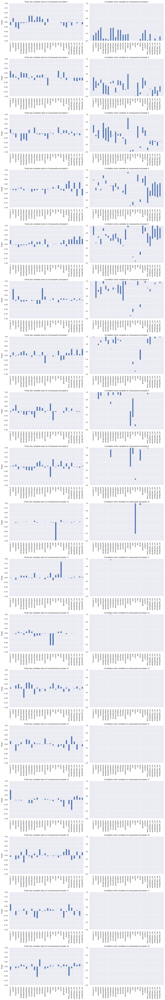

In [83]:
# Affichage des composantes principales
fig, axs = plt.subplots(pca.n_components_, 2, figsize=(15, 5*pca.n_components_))
index = df.columns[:-1]
bar_width = 0.5
y_offset = np.zeros(len(index))

for i in range(pca.n_components_):
    axs[i, 0].set_title('Poids des variables dans la Composante principale {}'.format(i+1))
    pd.Series(pca.components_[i], index=index).plot.bar(ax=axs[i, 0])
    axs[i, 0].set_ylabel('Poids')
    axs[i, 0].set_ylim(-1, 1)
    
    axs[i, 1].set_title('Corrélation entre variables et composante principale {}'.format(i+1))
    corr = np.abs(pca.components_[i])
    axs[i, 1].bar(index, corr, width=bar_width, bottom=y_offset)
    y_offset = y_offset + corr
    axs[i, 1].set_ylim(0, 1)
    axs[i, 1].tick_params(axis='x', rotation=90)

plt.tight_layout()
plt.show()

> Chaque barre correspond à l'importance des différentes variables dans la construction de la composante principale.

> Pour chaque graphique, on peut interpréter que les variables ayant des barres les plus hautes sont les plus importantes pour cette composante, et donc contribuent le plus à la variance expliquée par cette composante. 

> Les signes des barres peuvent indiquer si les variables sont positivement ou négativement corrélées à cette composante.

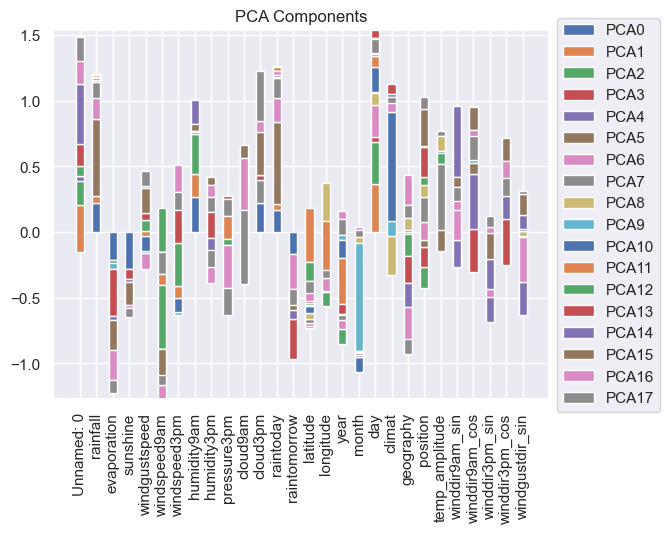

In [84]:
data = pca.components_

index = df.columns[:-1]
bar_width = 0.5

# Initialize the vertical-offset for the stacked bar chart.
y_offset = np.zeros(len(index))

for row in range(len(data)):
    plt.bar(index, data[row], bar_width, bottom=y_offset,label='PCA'+str(row))
    y_offset = y_offset + data[row]
   
    
plt.xticks(rotation=90)
plt.title('PCA Components')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


Le graphique représente les composantes principales générées à partir de l'analyse en composantes principales (PCA) appliquée sur les données du dataframe df. Chaque barre dans le graphique représente une variable dans le jeu de données et sa hauteur correspond à son poids dans la composition de chaque composante principale. Les différentes couleurs représentent les différentes composantes principales, numérotées de 0 à 4. La légende à droite du graphique montre quelle couleur correspond à quelle composante principale.

En examinant ce graphique, on peut voir comment chaque variable contribue aux différentes composantes principales et comment les différentes composantes principales sont liées les unes aux autres. Les variables qui ont des poids élevés dans les mêmes composantes principales sont considérées comme étant fortement corrélées. Les variables qui ont des poids élevés dans des composantes principales différentes sont considérées comme étant faiblement corrélées.

##### sauvegarde du dataset pca dans un dataframe exporté en csv

In [85]:
data

array([[-1.54035180e-01,  2.19743507e-01, -2.84804739e-01,
        -3.56900694e-01, -6.49900926e-02, -6.14797428e-02,
        -3.59576880e-02,  3.44270087e-01,  3.50472631e-01,
         1.01534867e-01,  2.98133470e-01,  2.95842434e-01,
         1.71715655e-01, -1.74471152e-01,  1.87107005e-01,
        -7.34766432e-03,  6.92347439e-03,  5.78401691e-03,
        -1.55509075e-03, -5.24987152e-02, -2.10279942e-01,
        -2.91485861e-01,  2.81863435e-02, -1.86890047e-01,
         3.19656170e-03, -6.52370763e-02,  1.24349538e-02,
        -1.22372180e-01],
       [ 3.57526311e-01,  1.93162493e-01,  7.16722748e-02,
        -9.61267345e-02,  2.98159232e-01,  2.42021951e-01,
         2.36074753e-01, -4.11293293e-02,  7.05204362e-02,
        -1.35609045e-01,  1.35453650e-01,  1.21819865e-01,
         1.75856781e-01, -2.37079464e-02, -4.14005531e-01,
        -3.12791983e-05,  3.45507900e-03, -1.47760308e-02,
         3.69904754e-01, -5.42948112e-02,  2.90488690e-01,
        -1.30436660e-01, -1.90

In [86]:
pca_data = pca.transform(data)


In [87]:
pca_data

array([[ 1.00000000e+00,  5.23178762e-15, -1.30011558e-14,
         4.96323843e-15,  5.06509019e-15,  1.72295683e-15,
        -8.55005336e-15, -4.29129910e-15,  2.84750339e-14,
        -3.87723417e-15, -2.01810065e-14,  3.52378804e-14,
         6.68739866e-15, -6.04237879e-15, -1.11468198e-15,
        -3.02683802e-15,  8.19302638e-15,  4.80666771e-15],
       [-2.65995115e-15,  1.00000000e+00, -1.32447945e-14,
         4.80310929e-15,  4.71535426e-15,  1.54938137e-15,
        -8.21449728e-15, -4.15081876e-15,  2.84977559e-14,
        -3.88145966e-15, -2.02192868e-14,  3.51953492e-14,
         6.64920590e-15, -6.12273928e-15, -1.18778545e-15,
        -3.01917841e-15,  8.30276159e-15,  4.81944415e-15],
       [-2.74293413e-15,  4.92402567e-15,  1.00000000e+00,
         4.89708606e-15,  5.68686140e-15,  1.68204565e-15,
        -8.65108227e-15, -4.36970610e-15,  2.86211373e-14,
        -3.86011114e-15, -2.01977559e-14,  3.51725938e-14,
         6.81567044e-15, -5.97167117e-15, -8.30512037e

In [88]:
pca_data.to_csv("../data/pca_data_features3.csv")

AttributeError: 'numpy.ndarray' object has no attribute 'to_csv'